In [1]:
#kidney perfusion samples annotation
import os
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response/code')
import anndata as ad
import scanpy as sc
import os
import pandas as pd
import numpy as np
import useful_functions as uf
import scvi
import scvelo as scv
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = False  # set max width size for presenter view
scv.settings.set_figure_params('scvelo')  # for beautified visualization
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)

sc.set_figure_params(figsize=(5,5), dpi = 150, fontsize = 10)
import sys
print(sys.executable)
import matplotlib as mpl
import matplotlib.pyplot as plt


from datetime import datetime
print(datetime.now(tz=None))

Global seed set to 0


/home/jovyan/my-conda-envs/myenv/bin/python
2023-07-12 16:53:18.462251


/home/jovyan/my-conda-envs/myenv/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/jovyan/my-conda-envs/myenv/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
import warnings
warnings.filterwarnings('ignore')
#this will hide the awful pandas deprec warnings that are currently plaguing scanpy

#now print versions
print(sc.__version__)
print(ad.__version__)
print(pd.__version__)
print(scvi.__version__)
print(scv.__version__)
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response')


1.9.1
0.8.0
1.5.1
0.19.0
0.2.5


In [3]:
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response/data')
adata = sc.read_h5ad("./trained/10X_3p/scanvae_perfusion_model/adata.h5ad")

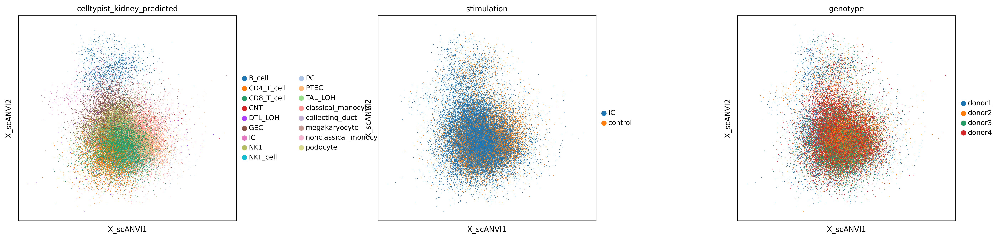

In [4]:
sc.pl.embedding(adata, basis = 'X_scANVI', color = ['celltypist_kidney_predicted', 'stimulation', 'genotype'], wspace = 0.5)

In [5]:
sc.pp.neighbors(adata, use_rep = 'X_scANVI') #we use the supervised scANVI analysis which uses celltypist labels to refine the embedding.
sc.tl.umap(adata)

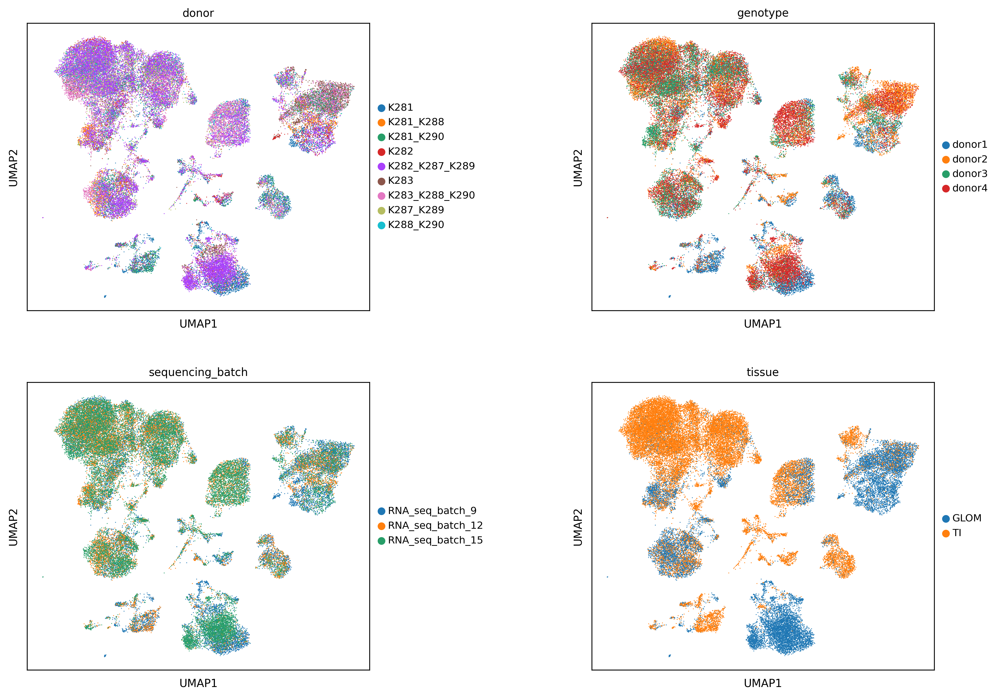

In [6]:
sc.pl.umap(adata, color = ['donor', 'genotype', 'sequencing_batch', 'tissue'], wspace = 0.5, ncols = 2)

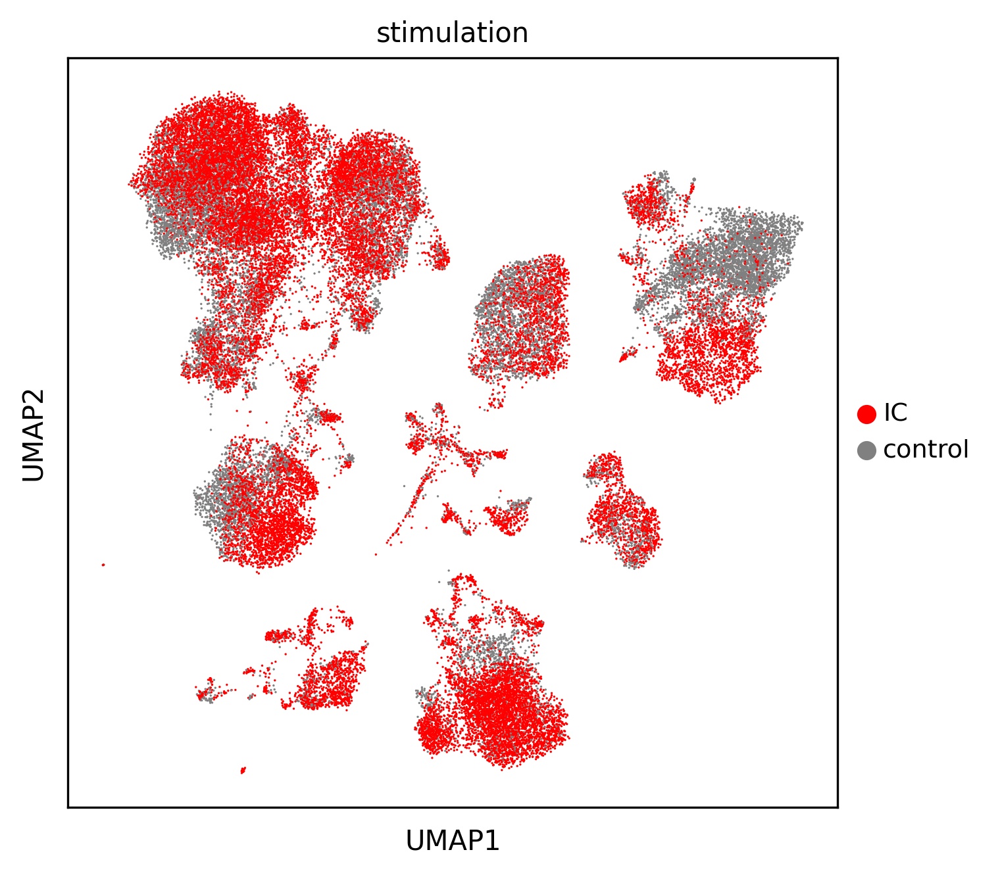

In [7]:
adata.uns['stimulation_colors'] = ['red', 'grey']
sc.pl.umap(adata, color = ['stimulation'], wspace = 0.2)

In [8]:
sc.tl.leiden(adata, resolution = 1)

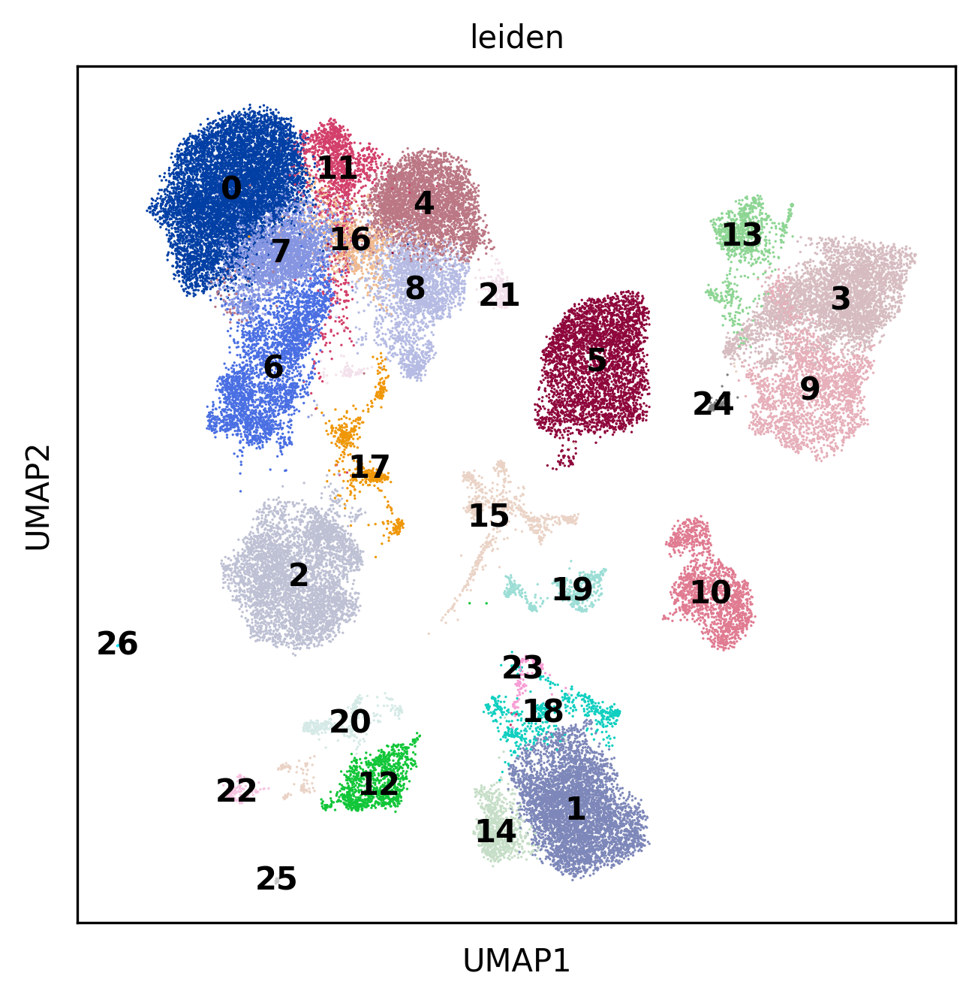

In [9]:
sc.pl.umap(adata, color = ['leiden'], legend_loc = 'on data')

In [10]:
#do subclustering and annotate...
adata.obs['celltype_clusters'] = adata.obs['leiden']
#these need clustering at a lower resolution
for comp in ['8', '15', '19', '18', '13', '17', '21', '10', '20', '6', '3']:
    print(comp)
    sc.tl.leiden(adata, restrict_to = ('celltype_clusters', [comp]), resolution = 0.2)
    adata.obs['celltype_clusters'] = adata.obs['leiden_R']

8
15
19
18
13
17
21
10
20
6
3


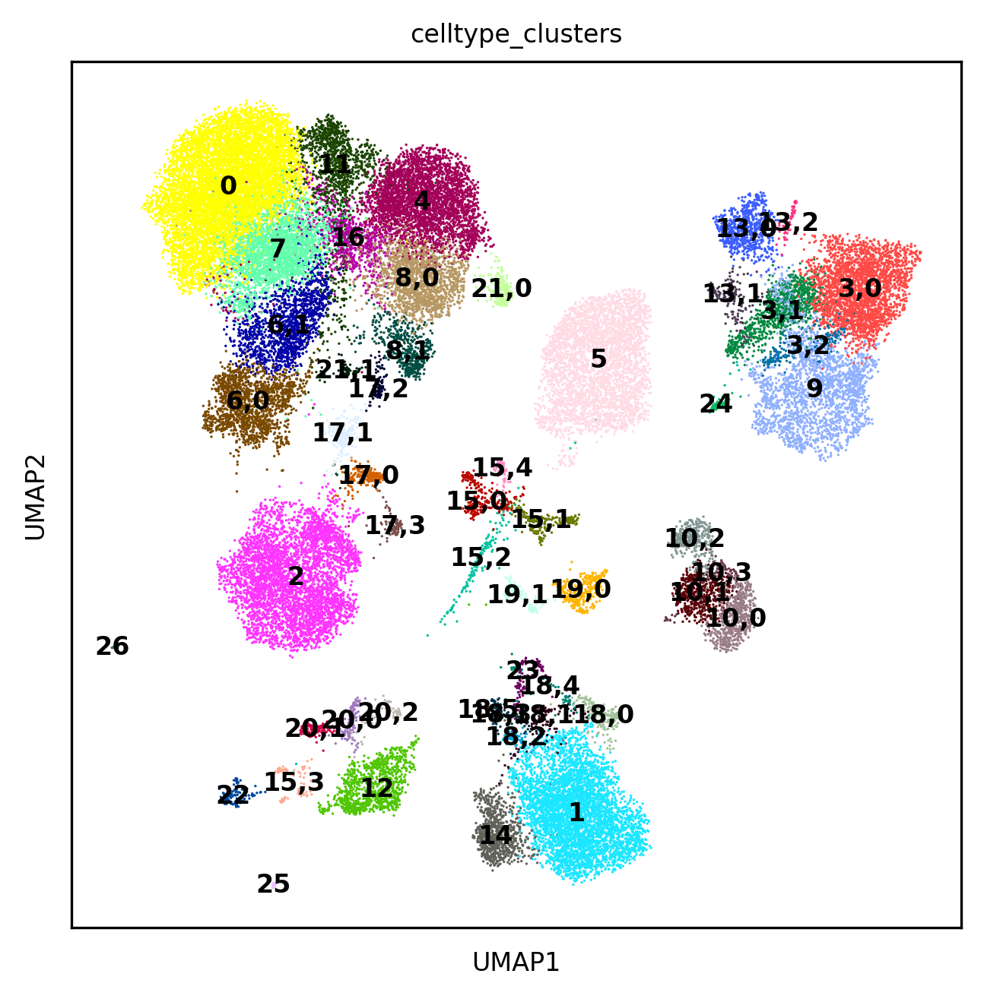

In [11]:
sc.set_figure_params(figsize=(5,5), dpi = 150, fontsize = 8)
sc.pl.umap(adata, color = ['celltype_clusters'], legend_loc = 'on data')

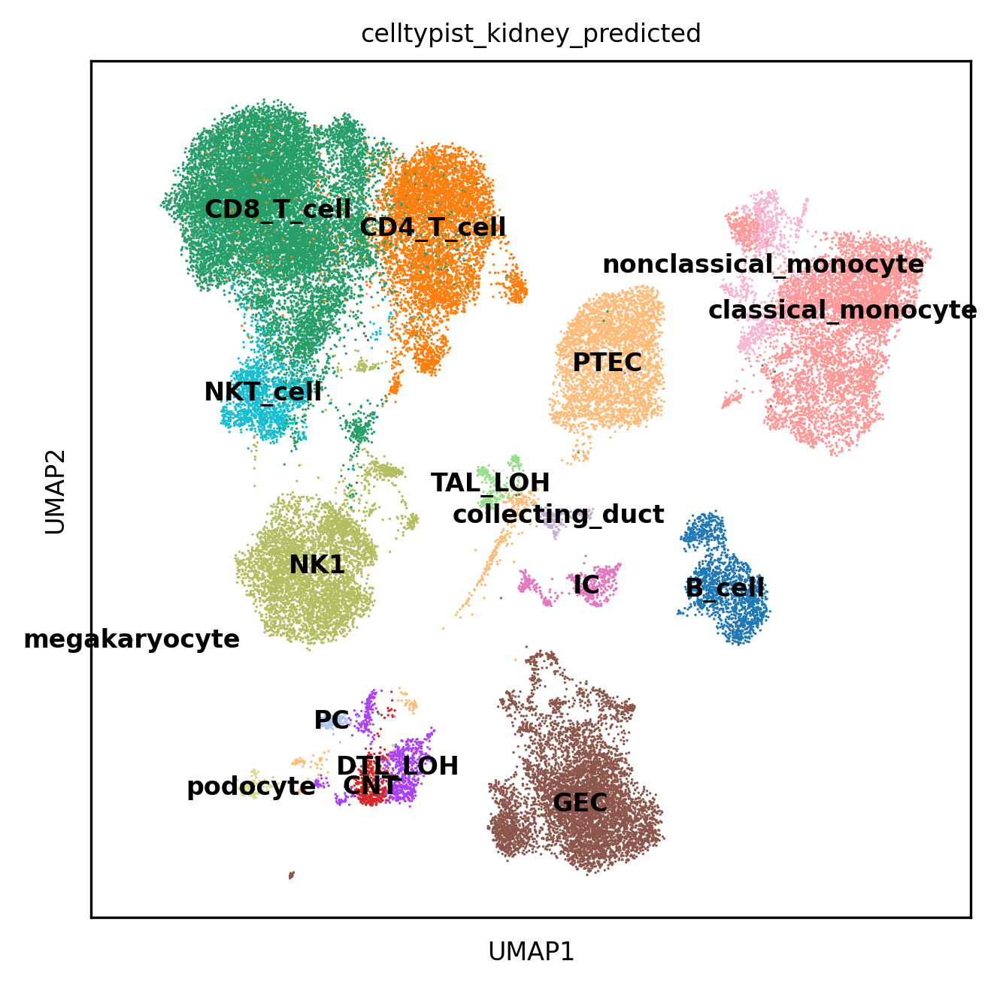

In [12]:
sc.pl.umap(adata, color = 'celltypist_kidney_predicted', legend_loc = 'on data')

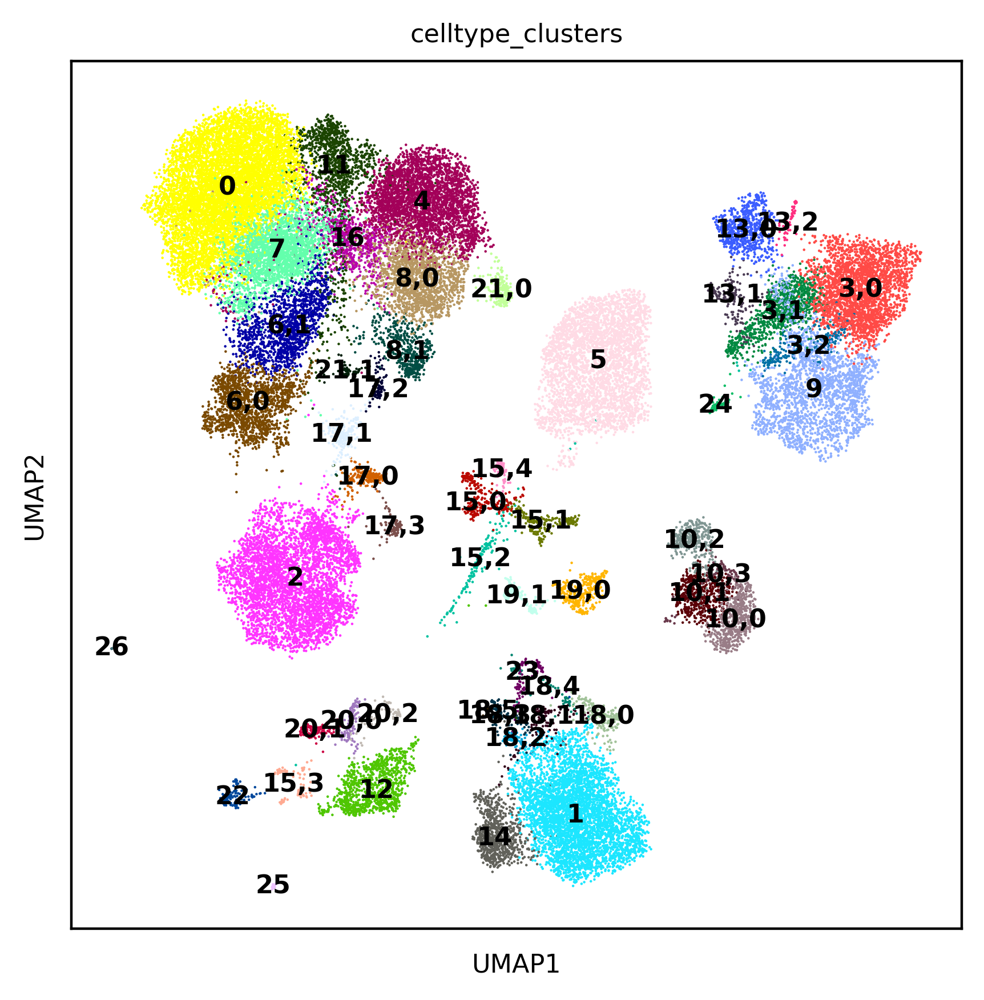

In [13]:
sc.set_figure_params(figsize=(5,5), dpi = 200, fontsize = 8)
sc.pl.umap(adata, color = ['celltype_clusters'], legend_loc = 'on data')

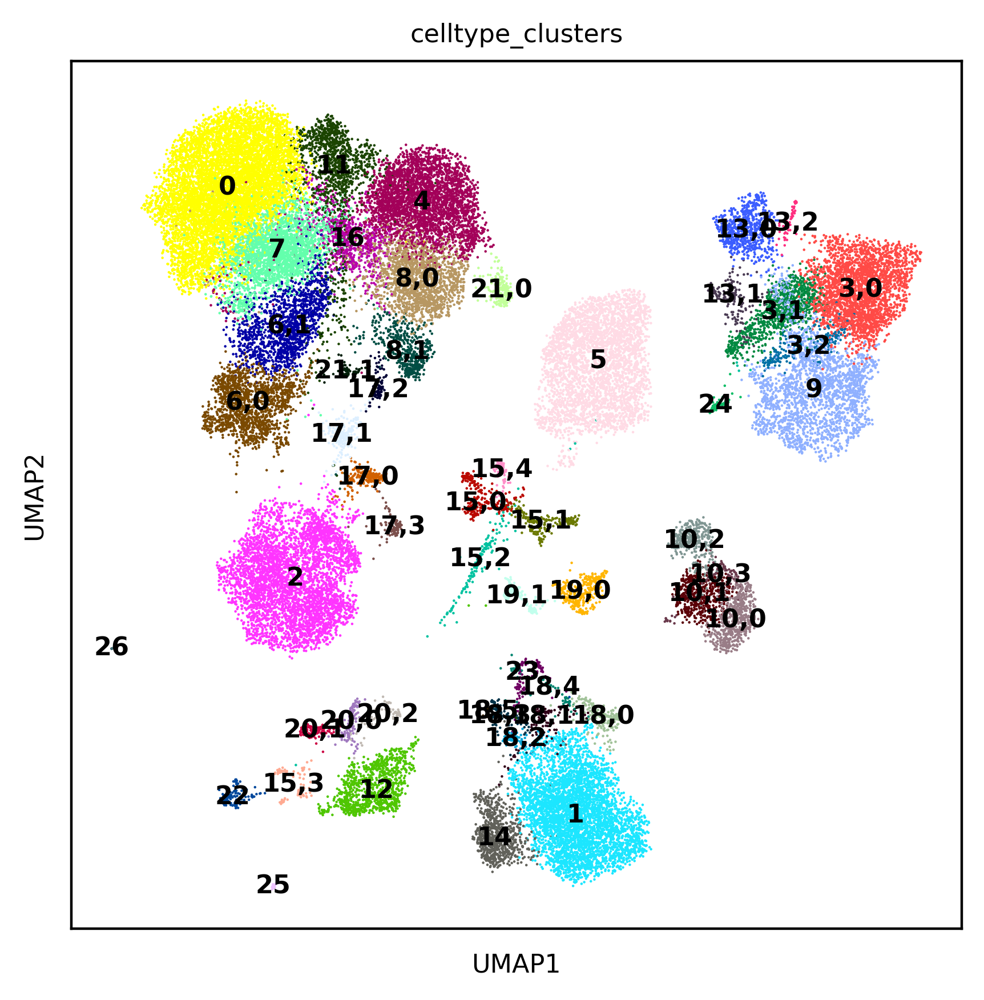

In [14]:
sc.set_figure_params(figsize=(5,5), dpi = 200, fontsize = 8)
sc.pl.umap(adata, color = ['celltype_clusters'], legend_loc = 'on data')

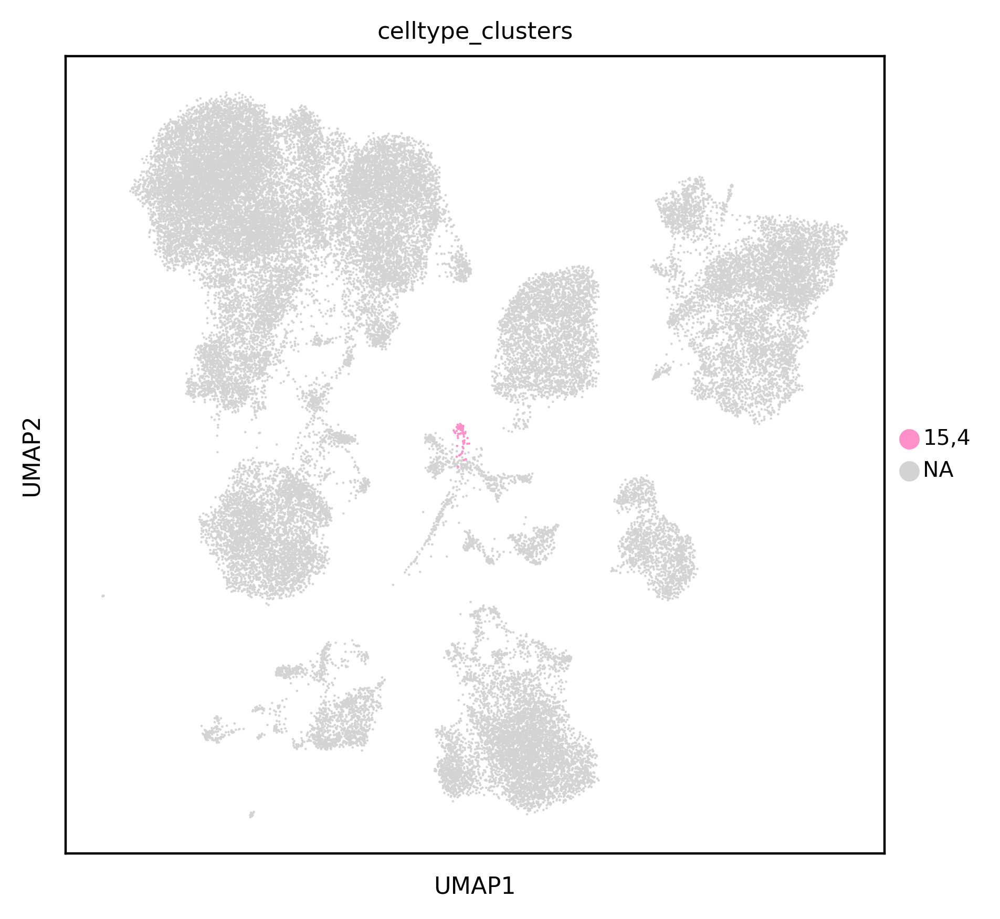

In [15]:
sc.pl.umap(adata, color = ['celltype_clusters'], groups = '15,4')

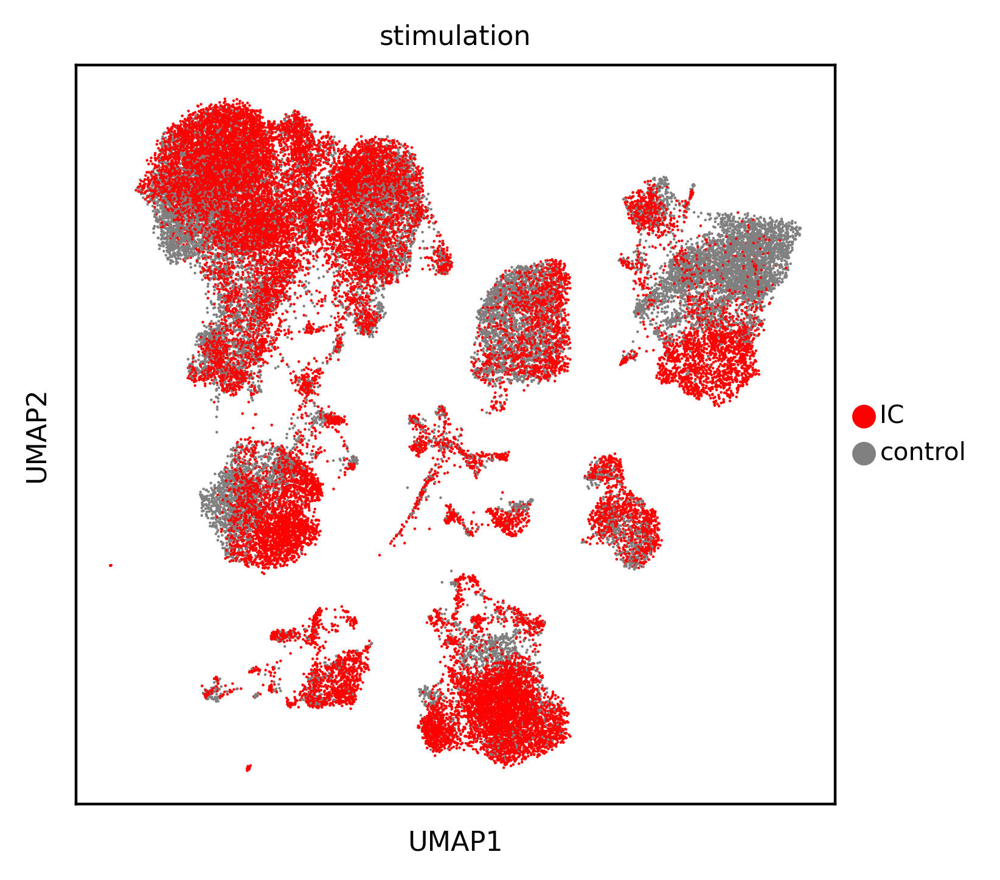

In [16]:
sc.set_figure_params(figsize=(4,4), dpi = 200, fontsize = 8)
sc.pl.umap(adata, color = ['stimulation'])

In [17]:
import geosketch as gs
idx = gs.gs(adata.obsm['X_scANVI'], 20000)
adata.obs['gs_idx'] = adata.obs_names.isin(adata.obs_names.values[idx])
#celltype_cluster_markers = uf.get_markers(adata[adata.obs['gs_idx']], 'celltype_clusters', 'spliced')

In [18]:
#celltype_cluster_markers['15,4'].head(10)

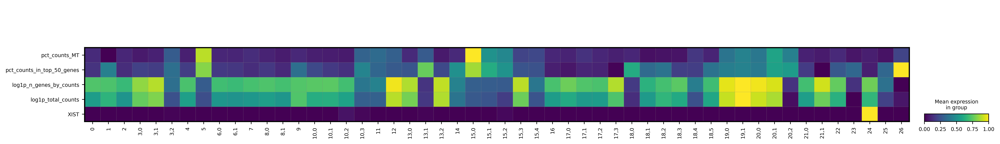

In [19]:
sc.pl.matrixplot(adata, var_names = ['pct_counts_MT', 'pct_counts_in_top_50_genes', 
                                     'log1p_n_genes_by_counts', 'log1p_total_counts','XIST'], 
           groupby = 'celltype_clusters', standard_scale = 'var', swap_axes = True, dendrogram = False)

In [20]:
#celltypist annotate immune cells
def get_counts_raw(adata):
    adata_counts = adata.uns['raw_adata'].copy()
    adata_counts = adata_counts[adata.obs_names]
    adata = adata.raw.to_adata()
    adata.layers = adata_counts.layers.copy()
    return(adata)

celltypist_adata = get_counts_raw(adata).copy()
celltypist_adata.X = celltypist_adata.layers['raw_counts']
sc.pp.normalize_total(celltypist_adata, target_sum = 10000)
sc.pp.log1p(celltypist_adata)
import celltypist
#do immune predictions
predictions = celltypist.annotate(celltypist_adata, model = 'Immune_All_Low.pkl', 
                                 majority_voting = True)

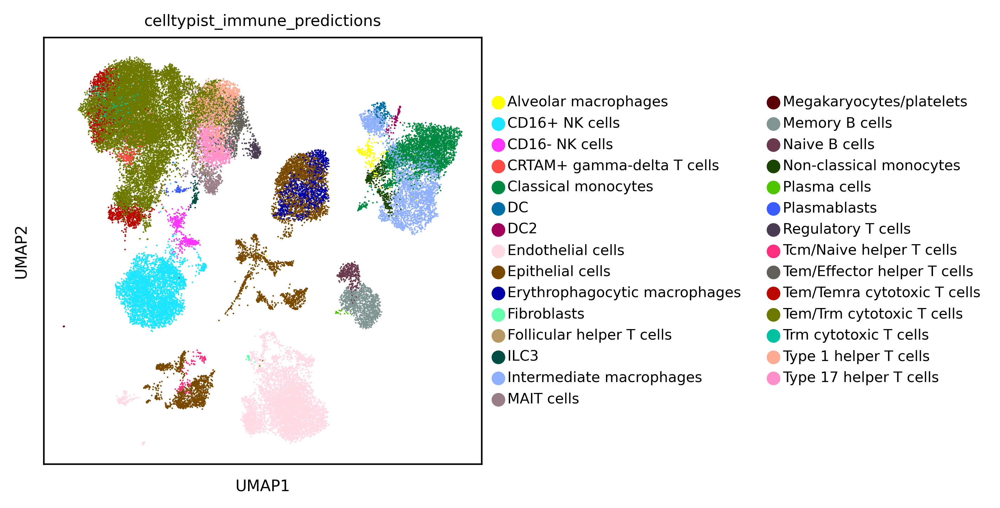

In [21]:
adata.obs['celltypist_immune_predictions'] = predictions.predicted_labels.majority_voting
sc.pl.umap(adata, color = 'celltypist_immune_predictions')

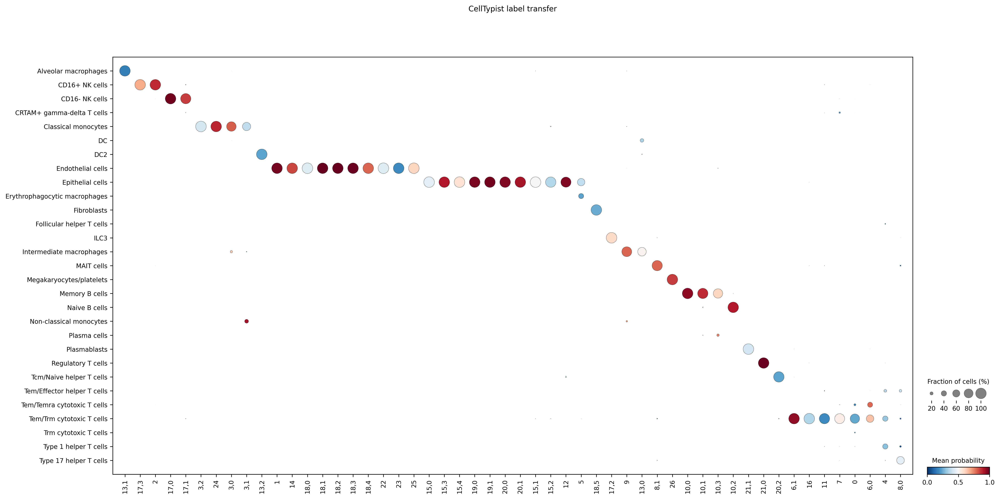

In [22]:
sc.set_figure_params(figsize=(5,5), dpi = 150, fontsize =10)
celltypist.dotplot(predictions, use_as_reference = 'celltype_clusters', use_as_prediction = 'majority_voting')

In [23]:
#introduce some cell type labels
#annotate cells

celltype_map = {
'0' : 'CD8_T_cell',
'1' : 'GEC',
'2' : 'NK1',
'3,0' : 'classical_monocyte',
'3,1' : 'nonclassical_monocyte',
'3,2' : 'low_quality',
'4' : 'CD4_T_cell_Th1',
'5' : 'convoluted_PTEC',
'6,0' : 'NKT_cell',
'6,1' : 'CD8_T_cell_GZMK',
'7' : 'CD8_T_cell_Trm',
'8,0' : 'CD4_T_cell_Th17',
'8,1' :  'MAIT',
'9' : 'classical_monocyte', #these are the stimulated ones but we bag them together
'10,0' : 'memory_B_cell',
'10,1' : 'memory_B_cell',
'10,2' : 'naive_B_cell',
'10,3' : 'memory_B_cell',
'11' : 'low_quality',
'12' : 'cortical_TAL_LOH',
'13,0' : 'TREM2_macrophage',
'13,1' : 'tissue_macrophage',
'13,2' : 'cDC1',
'14' : 'low_quality',
'15,0' : 'DCT',
'15,1' : 'CCD',
'15,2' : 'low_quality',
'15,3' : 'GPEC',
'15,4' : 'DCT',
'16' : 'CD8_T_cell_activated',
'17,0' : 'NK2',
'17,1' : 'NK2',
'17,2' : 'ILC',
'17,3' : 'proliferating_NK',
'18,0' : 'low_quality',
'18,1' : 'PCE',
'18,2' : 'PCE',
'18,3' : 'AE',
'18,4' : 'low_quality',
'18,5' : 'mesangial_cell',
'19,0' : 'IC_B',
'19,1' : 'IC_A',
'20,0' : 'DTL_LOH',
'20,1' : 'DTL_LOH',
'20,2' : 'low_quality',
'21,0' : 'Treg',
'21,1' : 'proliferating_T_cell',
'22' : 'podocyte',
'23' : 'low_quality',
'24' : 'low_quality', #XIST in an all male experiment
'25' : 'low_quality',
'26' : 'megakaryocyte'

}
# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata.obs['cell_type'] = adata.obs['celltype_clusters'].map(celltype_map).astype('category')

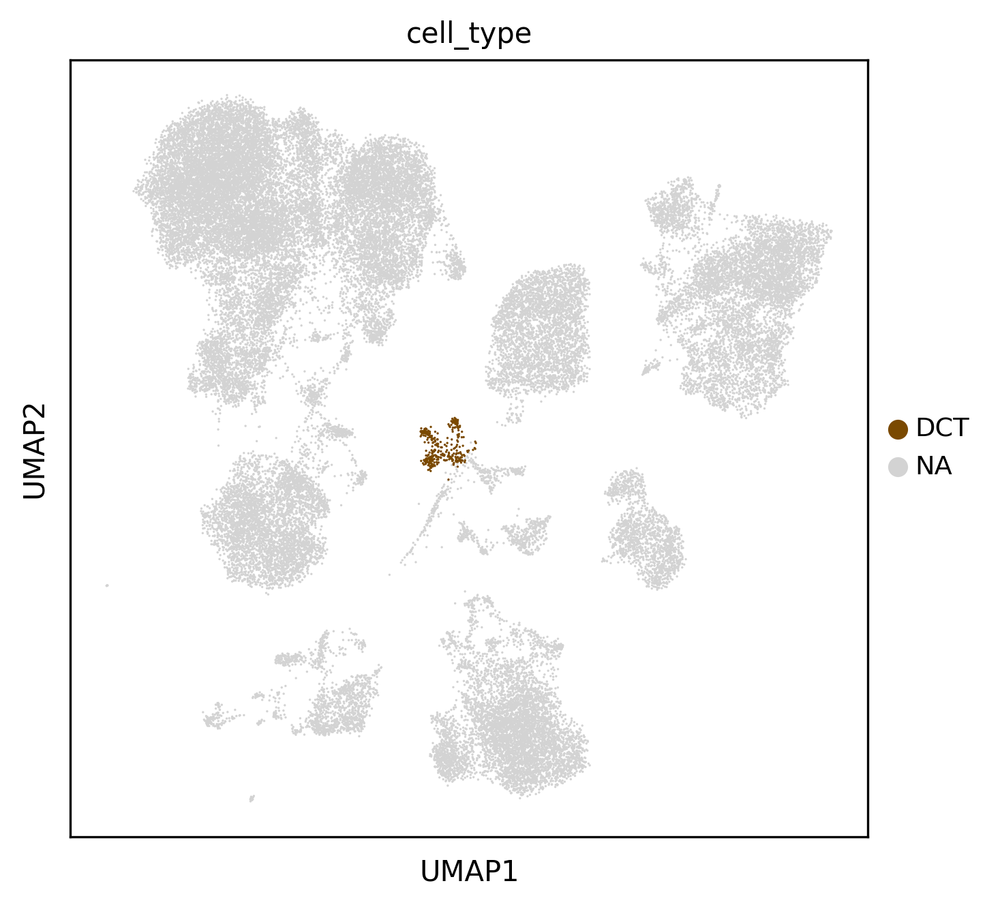

In [24]:
sc.pl.umap(adata, color = 'cell_type', groups = 'DCT')

In [25]:
#remove low quality and contaminants
adata = adata[np.invert(adata.obs['cell_type'].isin(["low_quality"]))]

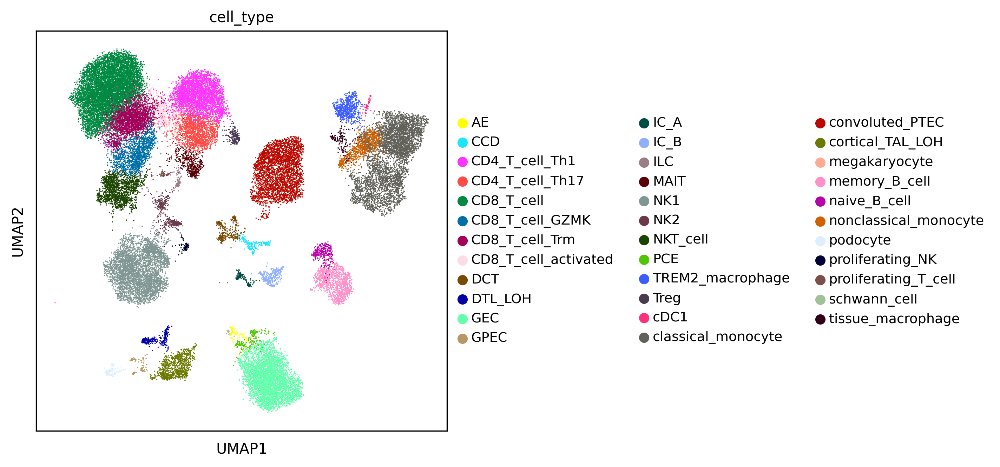

In [26]:
sc.pl.umap(adata, color = ['cell_type'])

In [27]:
#make the cell types categorical - copy this from the original atlas and add MAIT and GD
ct_categories = ['podocyte',
'convoluted_PTEC',
'straight_PTEC', 
'injured_PTEC',
'GPEC', 
'DTL_LOH',
'medullary_TAL_LOH',
'cortical_TAL_LOH',
'DCT', 
'CNT', 
'PC', 
'IC',
'IC_A', 
'IC_B',
'CCD', 
'AE',
'GEC', 
'prl_GEC',
'DVRE',
'PCE',                  
'MC', 
'VSMC',
'medullary_myofibroblast', 
'mesangial_cell',
'naive_B_cell', 
'memory_B_cell',
'plasma_cell',            
'CD4_T_cell',
'CD4_T_cell_Th17',
'CD4_T_cell_Th1',
'Treg',  
'ILC',
'MAIT',
'CD8_T_cell',
'CD8_T_cell_Trm',
'CD8_T_cell_GZMK',
'CD8_T_cell_activated',
'proliferating_T_cell',
'NK1', 
'activated_NK1',
'NK2',
'proliferating_NK',
'NKT_cell',
'cDC1', 
'cDC2', 
'classical_monocyte', 
'nonclassical_monocyte',
'nonclassical_monocyte_complement',
'lipid_handling_monocyte',
'proliferating_monocyte',
'tissue_macrophage',
'TREM2_macrophage',
'neutrophil',
'mast_cell',
'megakaryocyte'
]
adata.obs['cell_type'] = pd.Categorical(adata.obs['cell_type'], categories=ct_categories)
adata.obs['cell_type'] = adata.obs['cell_type'].cat.remove_unused_categories()

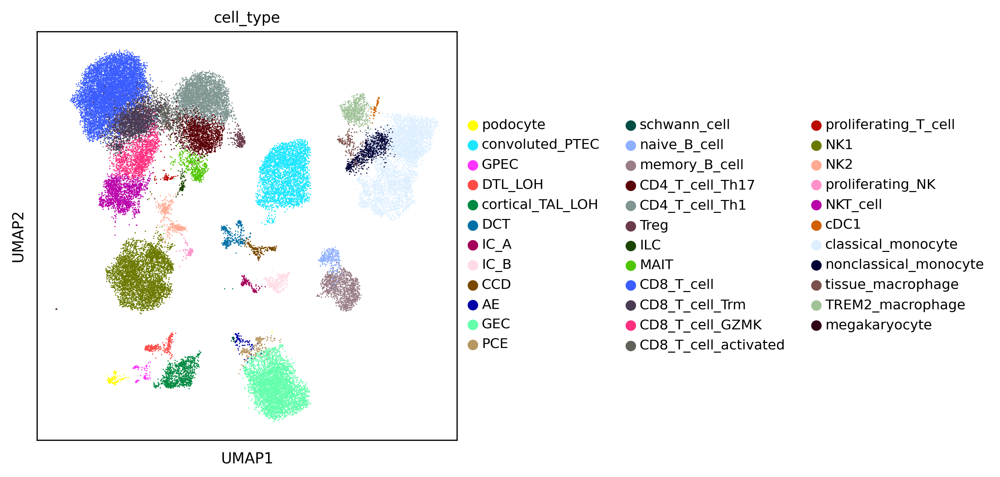

In [28]:
sc.pl.umap(adata, color = ['cell_type'])

In [29]:
sc.pp.neighbors(adata, use_rep = 'X_scANVI')

In [30]:
sc.tl.umap(adata, min_dist = 0.5)

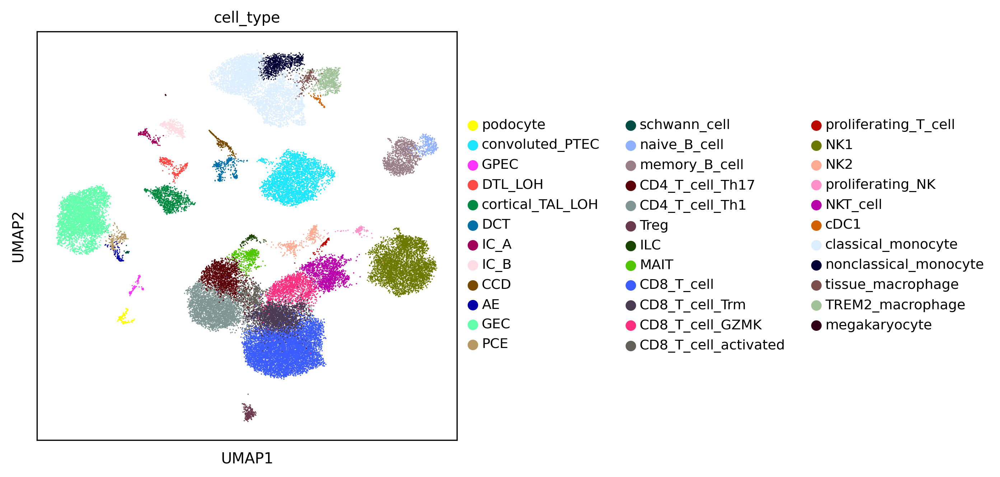

In [31]:
sc.pl.umap(adata, color = ['cell_type'])

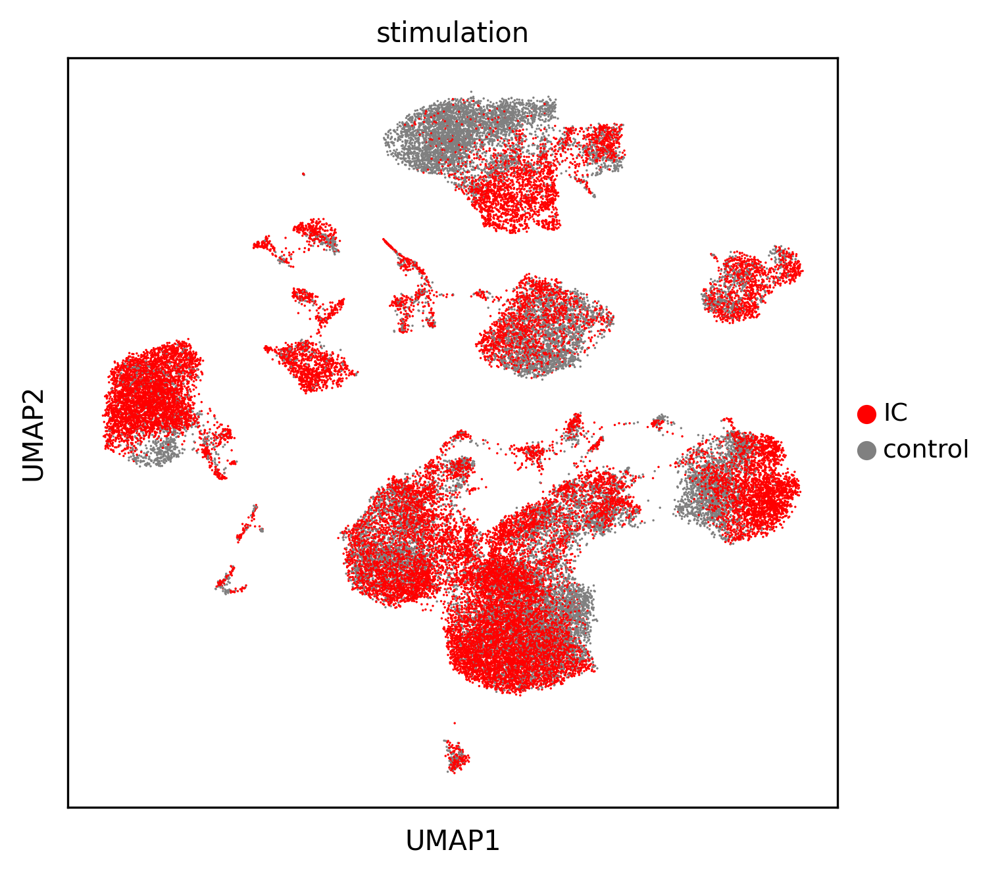

In [32]:
sc.pl.umap(adata, color = ['stimulation'])

In [33]:
#save this 
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response')
adata.write_h5ad("./data/annotated/scRNAseq_perturbation_kidney.h5ad")